In [1]:
import numpy as np
import anndata as ad
import sys
import os
import torch
sys.path.insert(1, '..')
from utils import *
import warnings
warnings.filterwarnings('ignore')
from os import path
from IPython.display import HTML

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
%reload_ext autoreload

# Subset of tissues

In [8]:
# Load data and embeddings
tissues_to_filter = ['Bladder', 'Heart', 'Kidney', 'Liver', 'Marrow', 'Thymus']
# Load encodings and data
enc = torch.load('./embeddings/SCVI_emb.pt')
all_anndata = ad.read('../dataset/all_tissue.h5ad')
all_anndata.obsm["X_scVI"] = enc

filter_all_anndata = all_anndata[all_anndata.obs['tissue'].isin(tissues_to_filter)]
filter_all_anndata.obs.sort_values(by="cell", inplace=True)

print(filter_all_anndata)

View of AnnData object with n_obs × n_vars = 12831 × 23433
    obs: 'cell_id', 'nCount_RNA', 'nFeature_RNA', 'channel', 'mouse.id', 'tissue', 'subtissue', 'mouse.sex', 'percent.ribo', 'percent.Rn45s', 'cell', 'cell_ontology_class', 'cell_ontology_term_iri', 'cell_ontology_id'
    obsm: 'X_scVI'


In [9]:
# Best hyper-parameters for clustering
metric = 'euclidean'
resolution = 1
init_pos = 'random'
use_rep = "X_scVI"
n_neigh = 15
n_pcs = enc.shape[1]

In [10]:
filter_all_anndata = find_clusters(filter_all_anndata, n_pcs=n_pcs, metric=metric, resolution=resolution, init_pos = init_pos, 
                            use_rep=use_rep, n_neigh=15, seed=42, return_anndata=True)

umap_32_euclidean_1_random.png
Silhouette 0.3290955424308777
SSE 90322.61421320878


In [11]:
print(f"Number of Clusters for SCVI embeddings: {len(filter_all_anndata.obs['louvain'].unique())}")

Number of Clusters for SCVI embeddings: 30


In [12]:
# Compute tSNE dimensionality reduction to better visualize embeddings
sc.tl.tsne(filter_all_anndata, n_pcs=n_pcs, use_rep="X_scVI", perplexity=30, early_exaggeration=12, random_state=42, metric=metric, n_jobs=10)

SCVI embeddings colored by cluster


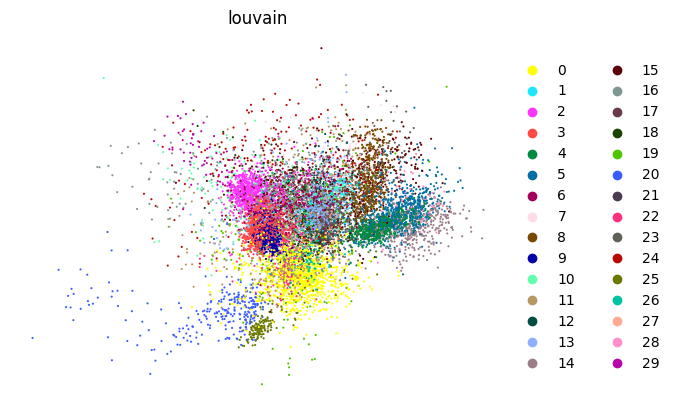

In [13]:
print("SCVI embeddings colored by cluster")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_scVI",
    frameon=False,
    color='louvain'
)

SCVI embeddings colored by cluster with tSNE


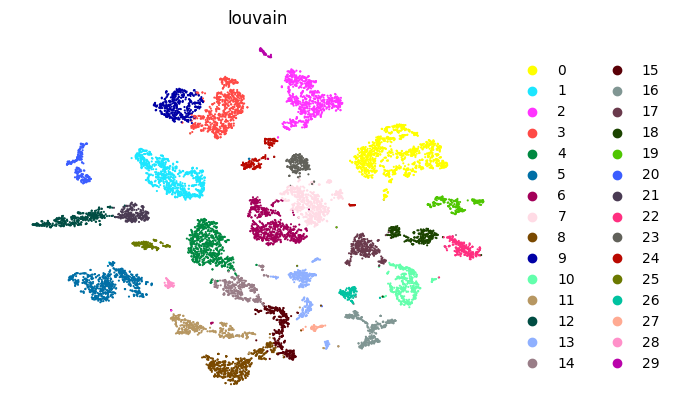

In [14]:
print("SCVI embeddings colored by cluster with tSNE")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_tsne",
    frameon=False,
    color='louvain'
)

SCVI embeddings colored by tissue


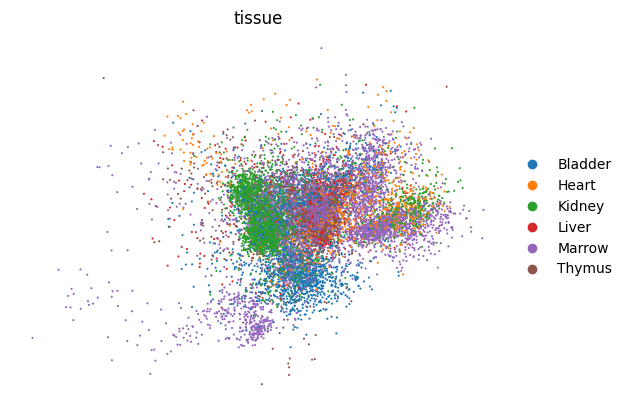

In [15]:
print("SCVI embeddings colored by tissue")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_scVI",
    frameon=False,
    color='tissue'
)

SCVI embeddings colored by tissue with tSNE


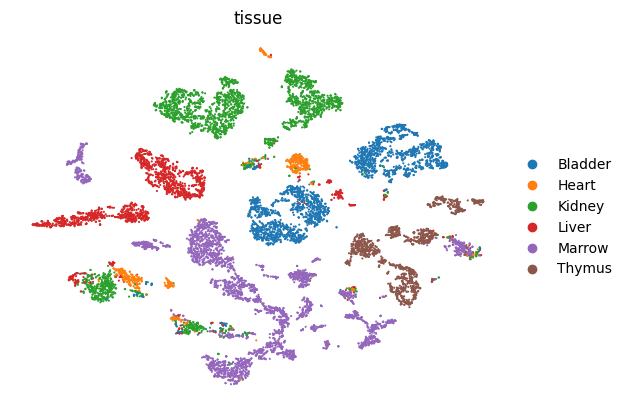

In [16]:
print("SCVI embeddings colored by tissue with tSNE")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_tsne",
    frameon=False,
    color='tissue'
)

SCVI embeddings colored by cell ontology class


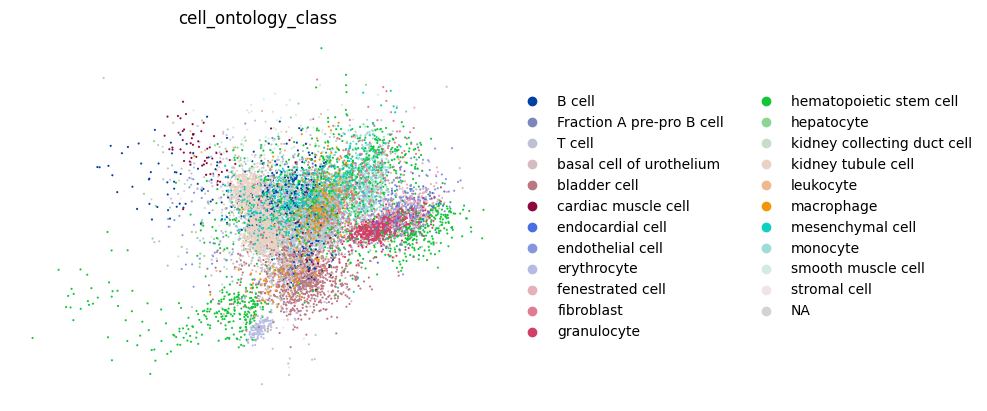

In [17]:
print("SCVI embeddings colored by cell ontology class")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_scVI",
    frameon=False,
    color='cell_ontology_class'
)

SCVI embeddings colored by cell ontology class with tSNE


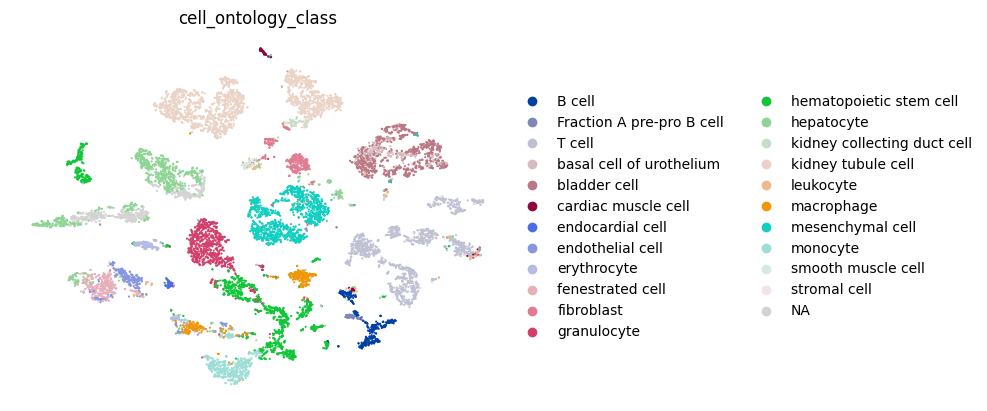

In [18]:
print("SCVI embeddings colored by cell ontology class with tSNE")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_tsne",
    frameon=False,
    color='cell_ontology_class'
)

SCVI embeddings colored by experiment


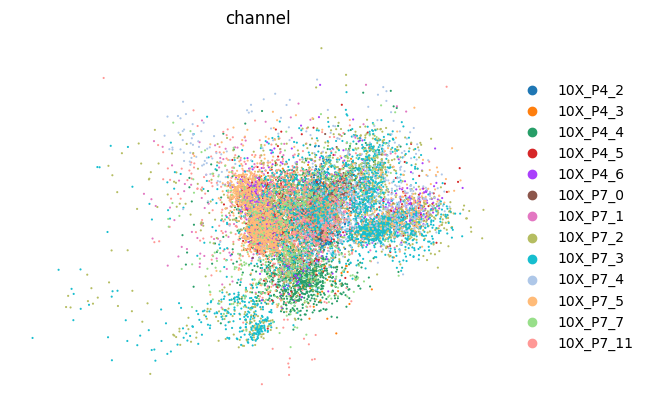

In [19]:
print("SCVI embeddings colored by experiment")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_scVI",
    frameon=False,
    color='channel'
)

SCVI embeddings colored by experiment with tSNE


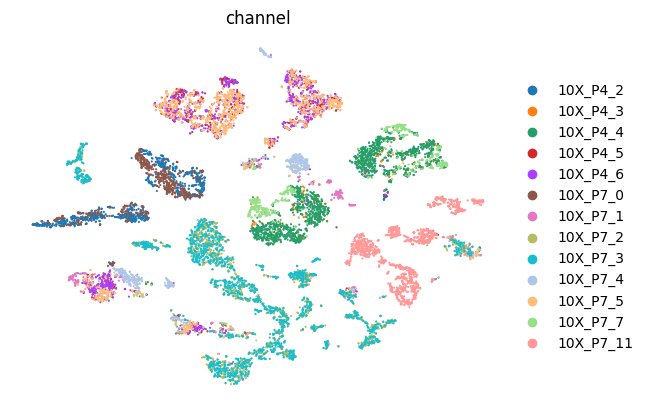

In [20]:
print("SCVI embeddings colored by experiment with tSNE")
sc.pl.embedding(
    filter_all_anndata,
    basis="X_tsne",
    frameon=False,
    color='channel'
)

In [21]:
# Load ground truth
tm_filter = pd.read_csv("../dataset/subset_cluster_tabula_muris.csv")
tm_filter.sort_values(by="cell", inplace=True)

In [22]:
print(f"Number of Clusters from ground truth: {len(tm_filter['cluster.ids'].unique())}")

Number of Clusters from ground truth: 21


# Purity w.r.t. Tabula Muris clusters

In [23]:
pur = compute_purity(adata_og = tm_filter['cluster.ids'], adata_pred = filter_all_anndata.obs['louvain'])
print(f"Purity between clusters using SCVI embeddings and without embeddings: {pur}")

Purity between clusters using SCVI embeddings and without embeddings: 0.5101706803834464


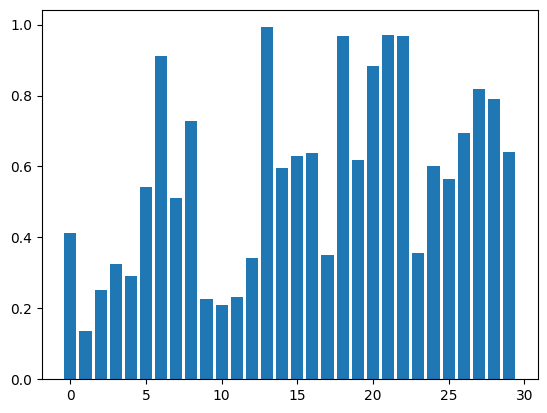

In [24]:
gen_purity_hist(tm_filter['cluster.ids'], filter_all_anndata.obs['louvain'])

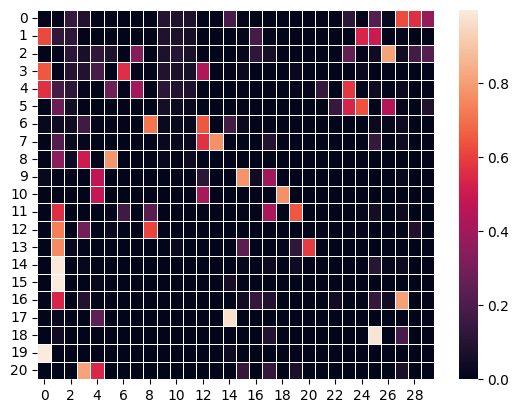

In [25]:
contingency_matrix = metrics.cluster.contingency_matrix(tm_filter['cluster.ids'], filter_all_anndata.obs['louvain'])
gen_heatmap(matrix = contingency_matrix)

## Purity w.r.t. cell ontology classes

In [26]:
values = tm_filter["cell_ontology_class"].unique()
d = dict((el, i) for i, el in enumerate(values))
tm_filter["cell_ontology_class" + '_discr'] = tm_filter["cell_ontology_class"].apply(lambda x: d[x])

In [27]:
pur = compute_purity(adata_og = tm_filter['cell_ontology_class_discr'], adata_pred = filter_all_anndata.obs['louvain'])
print(f"Purity between cell ontology classes of Tabula Muris and SCVI clusering: {pur}")

Purity between cell ontology classes of Tabula Muris and SCVI clusering: 0.8335281739537058


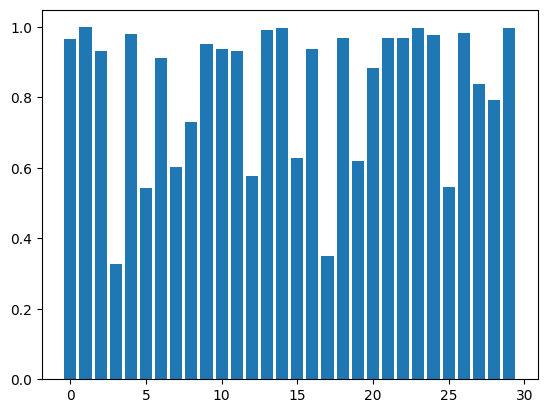

In [28]:
gen_purity_hist(tm_filter['cell_ontology_class_discr'], filter_all_anndata.obs['louvain'])

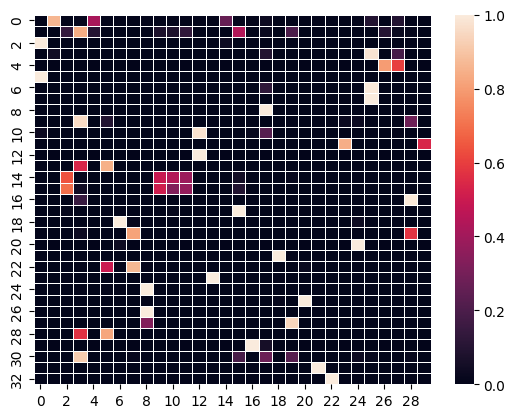

In [29]:
contingency_matrix = metrics.cluster.contingency_matrix(tm_filter['cell_ontology_class_discr'], filter_all_anndata.obs['louvain'])
gen_heatmap(matrix = contingency_matrix)

# Purity w.r.t. tissues

In [30]:
values = tm_filter["tissue"].unique()
d = dict((el, i) for i, el in enumerate(values))
tm_filter["tissue" + '_discr'] = tm_filter["tissue"].apply(lambda x: d[x])

In [31]:
pur = compute_purity(adata_og = tm_filter['tissue_discr'], adata_pred = filter_all_anndata.obs['louvain'])
print(f"Purity between tissues of Tabula Muris and SCVI clusering: {pur}")

Purity between tissues of Tabula Muris and SCVI clusering: 0.9208167718806016


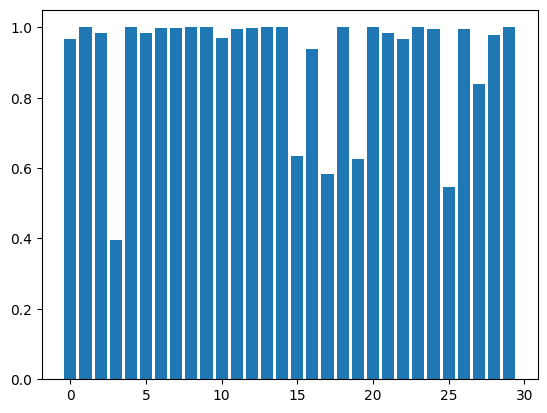

In [32]:
gen_purity_hist(tm_filter['tissue_discr'], filter_all_anndata.obs['louvain'])

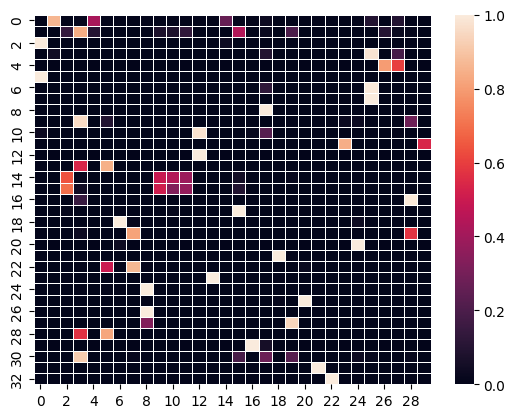

In [33]:
contingency_matrix_1 = metrics.cluster.contingency_matrix(tm_filter['tissue_discr'], filter_all_anndata.obs['louvain'])
gen_heatmap(matrix = contingency_matrix)

# Sankey plots

Sankey plot w.r.t. ground truth clusters and clusters resulting from SCVI

In [34]:
n_scvi_clust = len(filter_all_anndata.obs.louvain.unique())
jump = 3
for i in range(0, n_scvi_clust, jump):
    end_idx = i+jump
    plot_sankey(tm_filter, filter_all_anndata, field_og = 'cluster.ids', field_pred = 'louvain', filename = f"sankey_plots/subset/sankey{i}_{end_idx}", from_cls = i, to_cls = end_idx)

In [35]:
plot_sankey(tm_filter, filter_all_anndata, field_og = 'cluster.ids', field_pred = 'louvain', filename = f"sankey_plots/subset/sankey{0}_{n_scvi_clust}", from_cls = 0, to_cls = n_scvi_clust)
# Show the figure
HTML(filename=f"sankey_plots/subset/sankey0_{n_scvi_clust}.html")

Sankey plot w.r.t. ground truth tissues and clusters resulting from SCVI

In [37]:
plot_sankey(tm_filter, filter_all_anndata, field_og = 'tissue_discr', field_pred = 'louvain', filename = f"sankey_plots/subset/tissue_sankey{0}_{n_scvi_clust}", from_cls = 0, to_cls = n_scvi_clust)
# Show the figure
HTML(filename=f"sankey_plots/subset/tissue_sankey0_{n_scvi_clust}.html")

Sankey plot w.r.t. ground truth cell ontology class and clusters resulting from SCVI

In [38]:
plot_sankey(tm_filter, filter_all_anndata, field_og = 'cell_ontology_class_discr', field_pred = 'louvain', filename = f"sankey_plots/subset/cell_ontology_sankey{0}_{n_scvi_clust}", from_cls = 0, to_cls = n_scvi_clust)
# Show the figure
HTML(filename=f"sankey_plots/subset/cell_ontology_sankey0_{n_scvi_clust}.html")

---

# All tissues

In [4]:
# Load encodings and data
enc = torch.load('./embeddings/SCVI_emb.pt')
all_anndata = ad.read('../dataset/all_tissue.h5ad')
all_anndata.obsm["X_scVI"] = enc
all_anndata.obs.sort_values(by="cell", inplace=True)

In [5]:
all_anndata

AnnData object with n_obs × n_vars = 55656 × 23433
    obs: 'cell_id', 'nCount_RNA', 'nFeature_RNA', 'channel', 'mouse.id', 'tissue', 'subtissue', 'mouse.sex', 'percent.ribo', 'percent.Rn45s', 'cell', 'cell_ontology_class', 'cell_ontology_term_iri', 'cell_ontology_id'
    obsm: 'X_scVI'

In [5]:
# Best hyper-parameters for clustering
metric = 'cosine'
resolution = 1
init_pos = 'random'
n_neigh = 15
use_rep = "X_scVI"
n_pcs = enc.shape[1]

In [6]:
all_anndata = find_clusters(all_anndata, n_pcs=n_pcs, metric=metric, resolution=resolution, init_pos = init_pos, 
                            use_rep=use_rep, n_neigh=n_neigh, seed=42, return_anndata=True)

umap_32_cosine_1_random.png
Silhouette 0.26357924938201904
SSE 366872.0342503558


In [8]:
# Cluster id for each cell
all_anndata.obs[['cell_id','louvain']]

,cell_id,louvain
0,10X_P4_0_AAACCTGAGATTACCC-1,23
1,10X_P4_0_AAACCTGAGTGCCAGA-1,12
2,10X_P4_0_AAACCTGCAAATCCGT-1,21
3,10X_P4_0_AAACCTGGTAATCGTC-1,3
4,10X_P4_0_AAACCTGGTCCAACTA-1,23
...,...,...
55651,10X_P8_15_TTTGTCAGTTGTCGCG-1,1
55652,10X_P8_15_TTTGTCATCACGATGT-1,7
55653,10X_P8_15_TTTGTCATCGGCTTGG-1,1
55654,10X_P8_15_TTTGTCATCTTACCGC-1,5


In [7]:
print(f"Number of Clusters for SCVI embeddings: {len(all_anndata.obs['louvain'].unique())}")

Number of Clusters for SCVI embeddings: 45


In [10]:
# Compute tSNE dimensionality reduction to better visualize embeddings
sc.tl.tsne(all_anndata, n_pcs=n_pcs, use_rep="X_scVI", perplexity=30, early_exaggeration=12, random_state=42, metric=metric, n_jobs=10)

SCVI embeddings colored by cluster


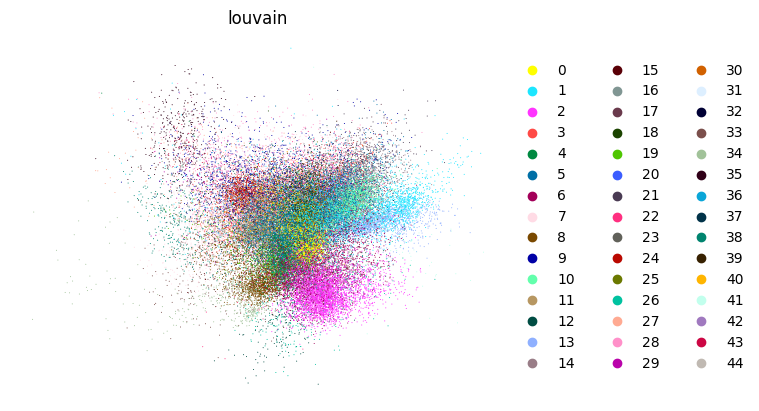

In [11]:
print("SCVI embeddings colored by cluster")
sc.pl.embedding(
    all_anndata,
    basis="X_scVI",
    frameon=False,
    color='louvain'
)

SCVI embeddings colored by cluster with tSNE


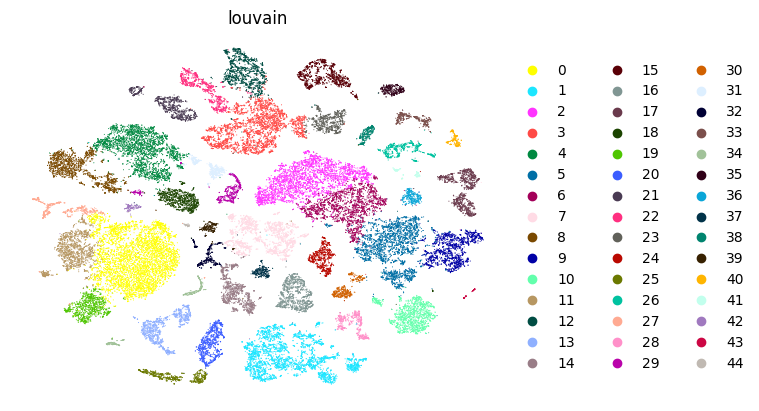

In [12]:
print("SCVI embeddings colored by cluster with tSNE")
sc.pl.embedding(
    all_anndata,
    basis="X_tsne",
    frameon=False,
    color='louvain'
)

SCVI embeddings colored by tissue


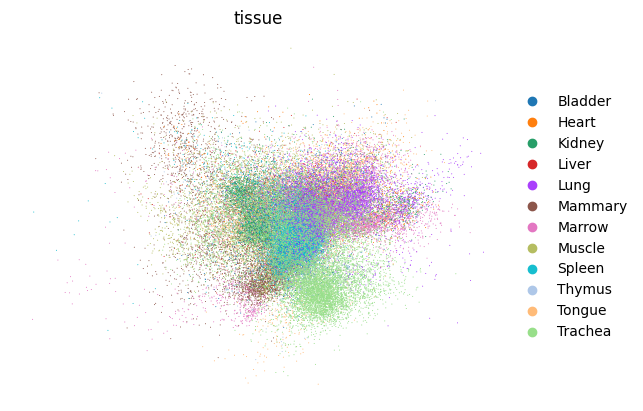

In [13]:
print("SCVI embeddings colored by tissue")
sc.pl.embedding(
    all_anndata,
    basis="X_scVI",
    frameon=False,
    color='tissue'
)

SCVI embeddings colored by tissue visualized with tSNE


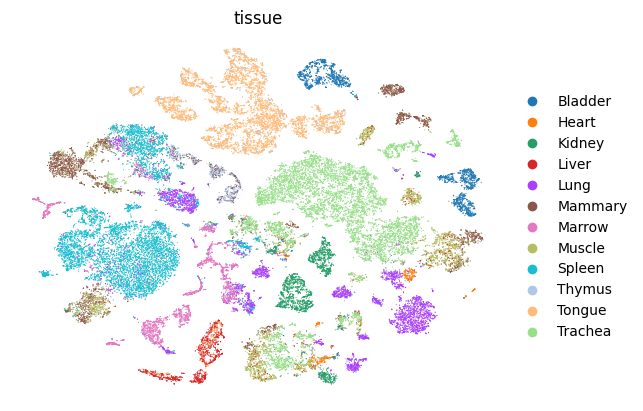

In [14]:
print("SCVI embeddings colored by tissue visualized with tSNE")
sc.pl.embedding(
    all_anndata,
    basis="X_tsne",
    frameon=False,
    color='tissue'
)

SCVI embeddings colored by cell ontology class


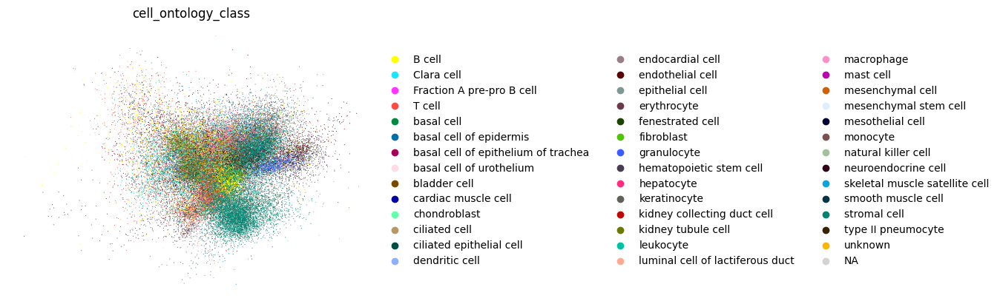

In [15]:
print("SCVI embeddings colored by cell ontology class")
sc.pl.embedding(
    all_anndata,
    basis="X_scVI",
    frameon=False,
    color='cell_ontology_class'
)

SCVI embeddings colored by cell ontology class with tSNE


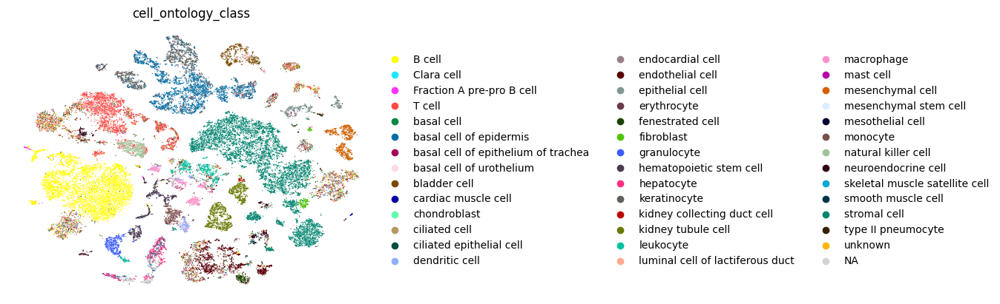

In [16]:
print("SCVI embeddings colored by cell ontology class with tSNE")
sc.pl.embedding(
    all_anndata,
    basis="X_tsne",
    frameon=False,
    color='cell_ontology_class'
)

SCVI embeddings colored by experiment


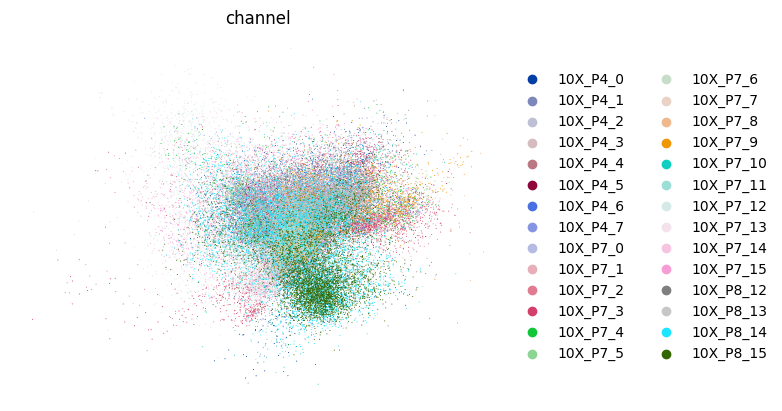

In [17]:
print("SCVI embeddings colored by experiment")
sc.pl.embedding(
    all_anndata,
    basis="X_scVI",
    frameon=False,
    color='channel'
)

SCVI embeddings colored by experiment with tSNE


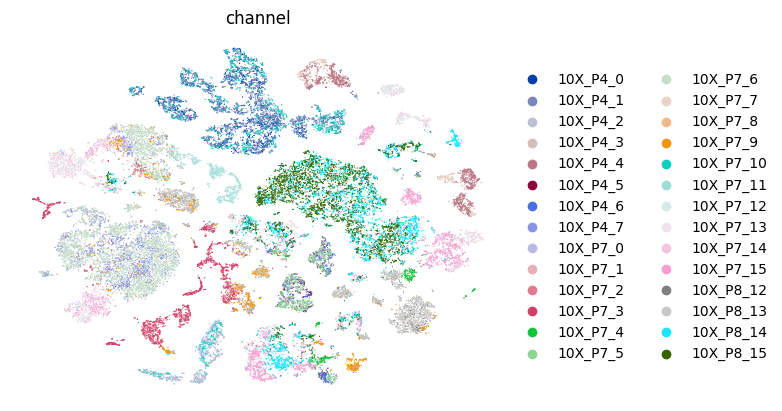

In [18]:
print("SCVI embeddings colored by experiment with tSNE")
sc.pl.embedding(
    all_anndata,
    basis="X_tsne",
    frameon=False,
    color='channel'
)

In [9]:
# Load ground truth clusters
tm = pd.read_csv("../dataset/cluster_tabula_muris.csv")
tm.sort_values(by='cell', inplace=True)
clusters_og = tm[['cell', 'cluster.ids']]
clusters_og

,cell,cluster.ids
0,10X_P4_0_AAACCTGAGATTACCC,2
1,10X_P4_0_AAACCTGAGTGCCAGA,1
2,10X_P4_0_AAACCTGCAAATCCGT,4
3,10X_P4_0_AAACCTGGTAATCGTC,0
4,10X_P4_0_AAACCTGGTCCAACTA,2
...,...,...
55651,10X_P8_15_TTTGTCAGTTGTCGCG,4
55652,10X_P8_15_TTTGTCATCACGATGT,3
55653,10X_P8_15_TTTGTCATCGGCTTGG,4
55654,10X_P8_15_TTTGTCATCTTACCGC,1


In [20]:
print(f"Number of Clusters from ground truth: {len(clusters_og['cluster.ids'].unique())}")

Number of Clusters from ground truth: 29


## Purity w.r.t. Tabula Muris clusters

In [21]:
pur = compute_purity(adata_og = clusters_og['cluster.ids'], adata_pred = all_anndata.obs['louvain'])
print(f"Purity between clusters using SCVI embeddings and without embeddings: {pur}")

Purity between clusters using SCVI embeddings and without embeddings: 0.4547038953571942


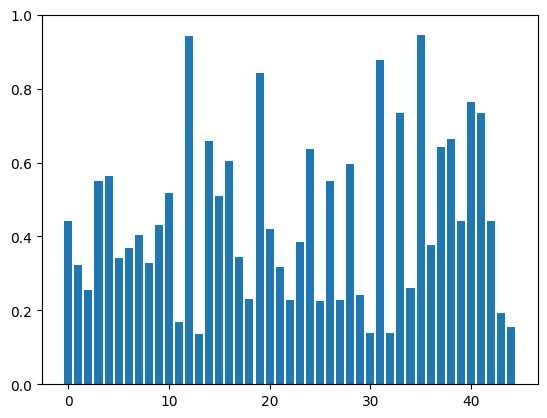

In [11]:
gen_purity_hist(clusters_og['cluster.ids'], all_anndata.obs['louvain'])

In [23]:
contingency_matrix = metrics.cluster.contingency_matrix(clusters_og['cluster.ids'], all_anndata.obs['louvain'])

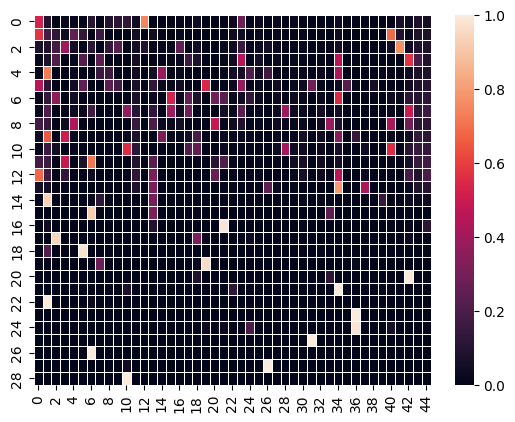

In [24]:
gen_heatmap(matrix = contingency_matrix)

## Purity w.r.t. Cell Ontology classes

In [14]:
values = tm["cell_ontology_class"].unique()
d = dict((el, i) for i, el in enumerate(values))
tm["cell_ontology_class" + '_discr'] = tm["cell_ontology_class"].apply(lambda x: d[x])

In [26]:
pur = compute_purity(adata_og = tm['cell_ontology_class_discr'], adata_pred = all_anndata.obs['louvain'])
print(f"Purity between Tabula Muris ontology and scVI clusters: {pur}")

Purity between Tabula Muris ontology and scVI clusters: 0.7232823055914905


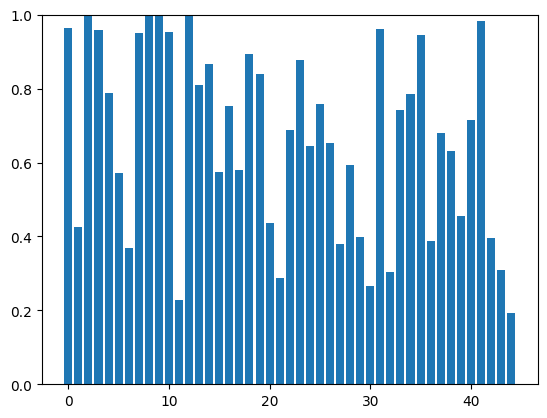

In [15]:
gen_purity_hist(tm['cell_ontology_class_discr'], all_anndata.obs['louvain'])

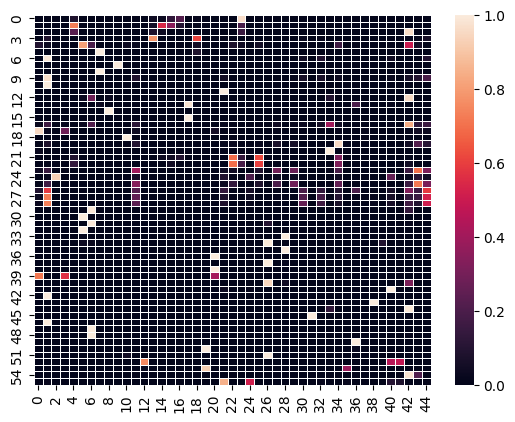

In [28]:
contingency_matrix = metrics.cluster.contingency_matrix(tm['cell_ontology_class_discr'], all_anndata.obs['louvain'])
gen_heatmap(matrix = contingency_matrix)

## Purity w.r.t. Tissues

In [29]:
values = tm["tissue"].unique()
d = dict((el, i) for i, el in enumerate(values))
tm["tissue" + '_discr'] = tm["tissue"].apply(lambda x: d[x])

In [30]:
pur = compute_purity(adata_og = tm['tissue_discr'], adata_pred = all_anndata.obs['louvain'])
print(f"Purity between Tabula Muris tissues and scVi clusters: {pur}")

Purity between Tabula Muris tissues and scVi clusters: 0.7996981457524796


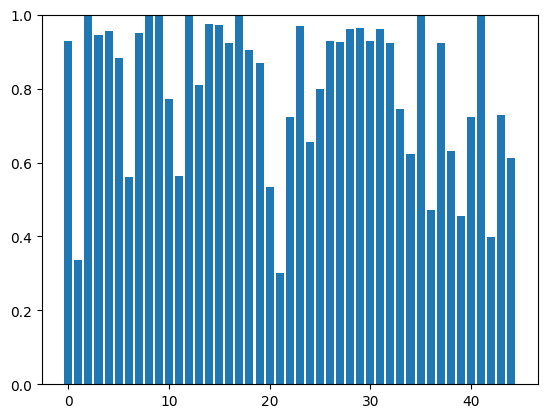

In [13]:
gen_purity_hist(tm['tissue_discr'], all_anndata.obs['louvain'])

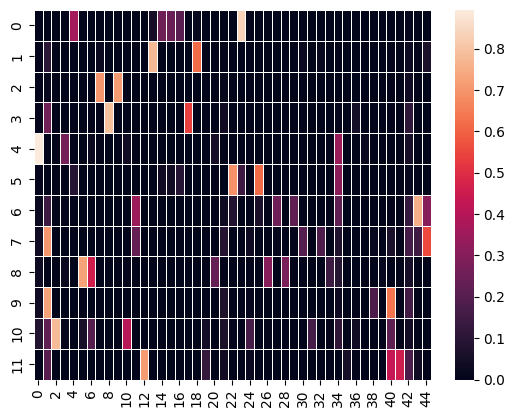

In [32]:
contingency_matrix = metrics.cluster.contingency_matrix(tm['tissue_discr'], all_anndata.obs['louvain'])
gen_heatmap(matrix = contingency_matrix)

## Sankey plots

Sankey plot w.r.t. ground truth clusters and clusters resulting from SCVI

In [33]:
n_scvi_clust = len(all_anndata.obs.louvain.unique())
plot_sankey(tm, all_anndata, field_og = 'cluster.ids', field_pred = 'louvain', filename = f"sankey_plots/all/sankey{0}_{n_scvi_clust}", from_cls = 0, to_cls = n_scvi_clust)
# Show the figure
HTML(filename=f"sankey_plots/all/sankey0_{n_scvi_clust}.html")

Sankey plot w.r.t. ground truth tissues and clusters resulting from SCVI

In [34]:
plot_sankey(tm, all_anndata, field_og = 'tissue_discr', field_pred = 'louvain', filename = f"sankey_plots/all/tissue_sankey{0}_{n_scvi_clust}", from_cls = 0, to_cls = n_scvi_clust)
# Show the figure
HTML(filename=f"sankey_plots/all/tissue_sankey0_{n_scvi_clust}.html")

Sankey plot w.r.t. ground truth cell ontology class and clusters resulting from SCVI

In [35]:
plot_sankey(tm, all_anndata, field_og = 'cell_ontology_class_discr', field_pred = 'louvain', filename = f"sankey_plots/all/cell_ont_sankey{0}_{n_scvi_clust}", from_cls = 0, to_cls = n_scvi_clust)
# Show the figure
HTML(filename=f"sankey_plots/all/cell_ont_sankey0_{n_scvi_clust}.html")